# Création des graphes - Contacts in a workplace in 2015
Importation des librairies

In [294]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import random


Importation des datasets

In [295]:
contacts_dataframe = pd.read_csv('datasets/cleaned/contacts_2015.csv')
departments_dataframe = pd.read_csv('datasets/cleaned/departments_2015.csv')

Informations générales

In [296]:
# Créer un graphe dirigé à partir du premier dataset
G = nx.from_pandas_edgelist(contacts_dataframe, 'IDWorker1', 'IDWorker2', ['Duration'], create_using=nx.Graph())

# Nombre de nœuds et d'arêtes
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Densité du graphe
density = nx.density(G)

# Nombre de composantes connectées
connected_components = nx.number_connected_components(G)

# Calcul des degrés
degrees = [degree for node, degree in G.degree()]

# Affichage des informations
print(f"Nombre de nœuds: {num_nodes}")
print(f"Nombre d'arêtes: {num_edges}")
print(f"Densité du graphe: {density:.4f}")
print(f"Nombre de composantes connectées: {connected_components}")

Nombre de nœuds: 217
Nombre d'arêtes: 4274
Densité du graphe: 0.1824
Nombre de composantes connectées: 1


Statistiques sur les degrés

In [297]:
# Calcul de la moyenne, médiane et quantiles des degrés
mean_degree = np.mean(degrees)
median_degree = np.median(degrees)
quantile_75 = np.percentile(degrees, 75)
quantile_90 = np.percentile(degrees, 90)

# Identifier les nœuds avec un degré élevé
degrees = dict(G.degree())
high_degree_nodes = [node for node, degree in degrees.items() if degree > quantile_90]

# Affichage des statistiques
print(f"Moyenne des degrés: {mean_degree:.2f}")
print(f"Médiane des degrés: {median_degree}")
print(f"75e quantile des degrés: {quantile_75}")
print(f"90e quantile des degrés: {quantile_90}")
print(f"Nœuds à haut degré: {high_degree_nodes}")

Moyenne des degrés: 39.39
Médiane des degrés: 39.0
75e quantile des degrés: 51.0
90e quantile des degrés: 58.0
Nœuds à haut degré: [1362, 215, 649, 1090, 147, 77, 160, 74, 122, 741, 378, 3, 603, 884, 267, 706, 246, 882, 250, 428, 836]


Affichage des noeuds fortement connectés

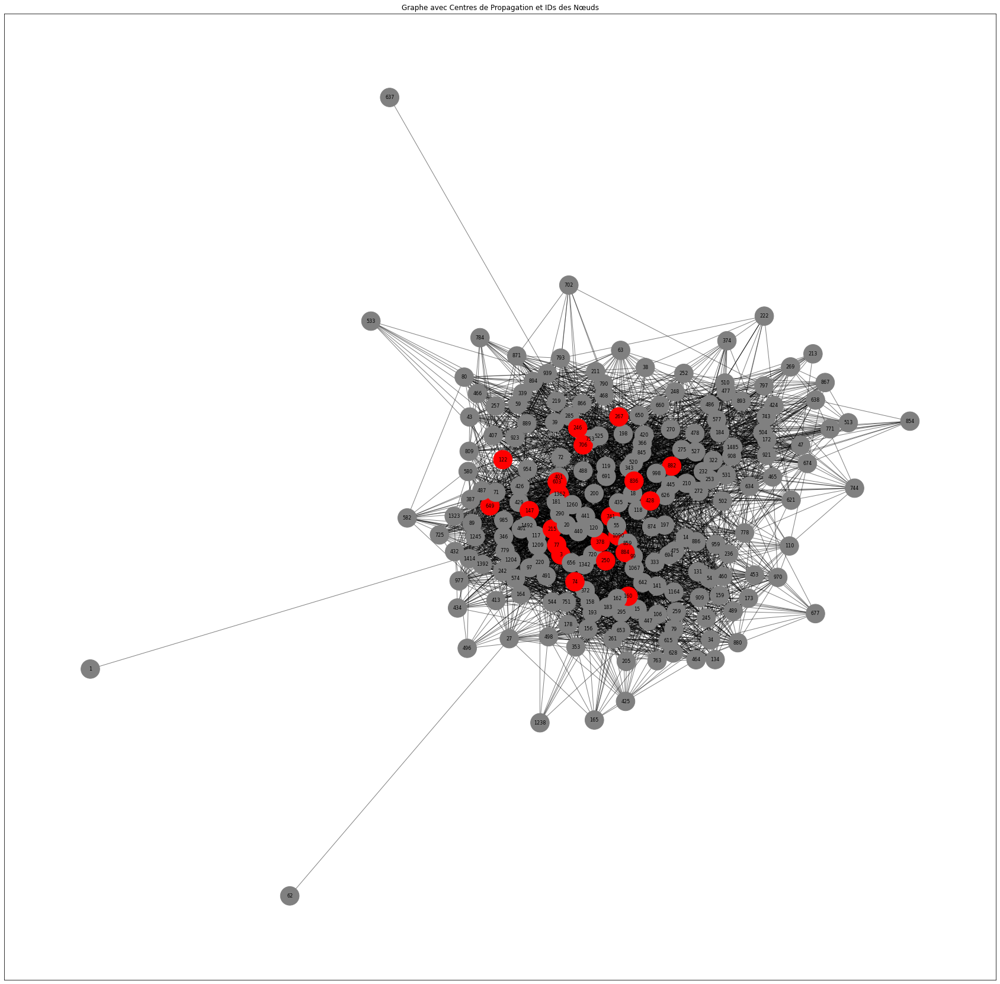

In [298]:
propagation_centers = high_degree_nodes

# Création du graphe à partir des données
G = nx.from_pandas_edgelist(contacts_dataframe, 'IDWorker1', 'IDWorker2', create_using=nx.Graph())

# Appliquer l'algorithme de Louvain pour détecter les communautés
communities = nx.algorithms.community.louvain_communities(G)

# Création d'une mapping de couleur pour chaque nœud
node_color = ['red' if node in propagation_centers else 'gray' for node in G.nodes]

# Dessiner le graphe avec les IDs des nœuds
plt.figure(figsize=(30, 30))
pos = nx.spring_layout(G, seed=42)
nx.draw_networkx_edges(G, pos, alpha=0.5)
nx.draw_networkx_nodes(G, pos, node_color=node_color, node_size=1000)
nx.draw_networkx_labels(G, pos, font_size=8)
plt.title('Graphe avec Centres de Propagation et IDs des Nœuds')
plt.show()

Simulation epidémiologique SIR

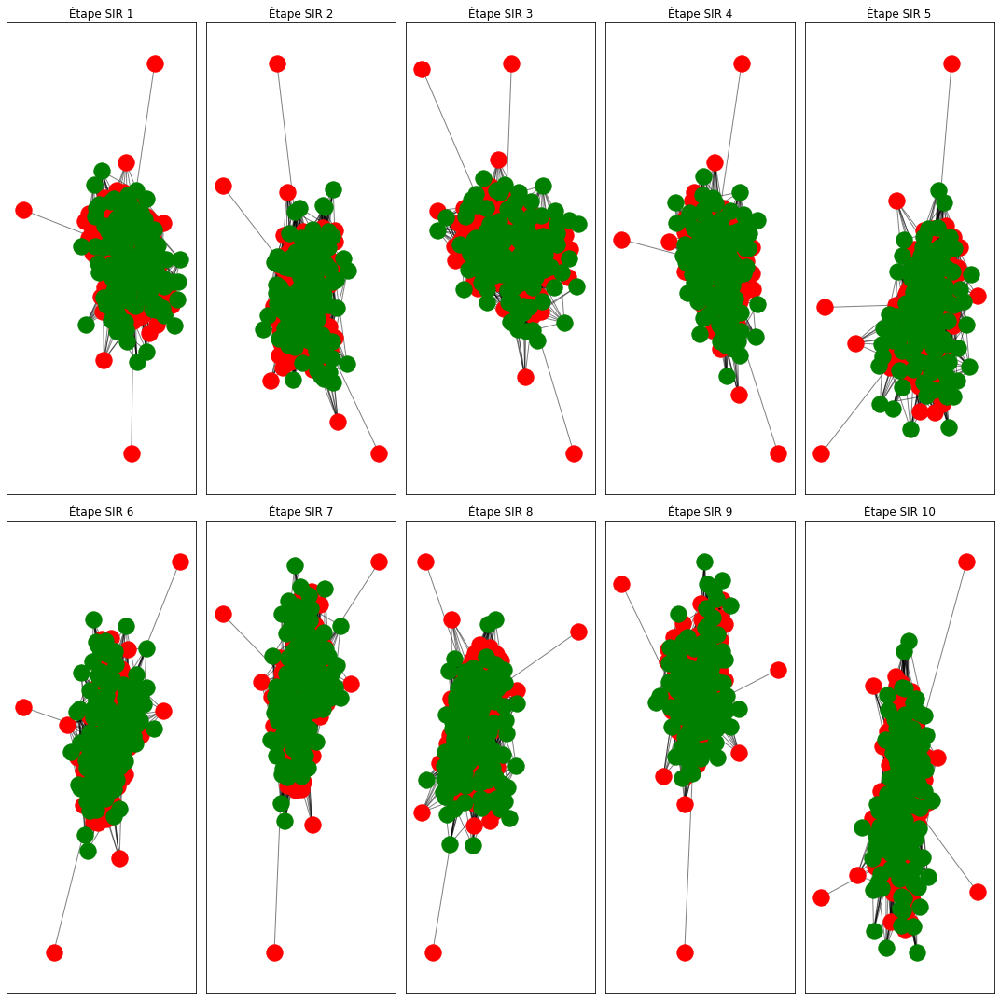

In [299]:


# Supposons que high_degree_nodes contient les nœuds fortement connectés (centres de propagation)
propagation_centers = high_degree_nodes

# Création du graphe à partir des données
G = nx.from_pandas_edgelist(contacts_dataframe, 'IDWorker1', 'IDWorker2', create_using=nx.Graph())

# Associer les départements aux nœuds
department_mapping = dict(zip(departments_dataframe['IDWorker'], departments_dataframe['Department']))
nx.set_node_attributes(G, department_mapping, 'department')

# Appliquer l'algorithme de Louvain pour détecter les communautés
communities = nx.algorithms.community.louvain_communities(G)

# Création d'une mapping de couleur pour chaque communauté
colors = [plt.cm.tab20(i) for i in range(len(communities))]
community_color = {}
for i, community in enumerate(communities):
    for node in community:
        community_color[node] = colors[i]

# Sélectionner un seul nœud fortement connecté comme point de départ de l'infection
initial_infected_node = random.choice(high_degree_nodes)

# Ajouter une couleur distincte pour le nœud initial infecté
community_color[initial_infected_node] = 'orange'

# Ajouter une couleur distincte pour les centres de propagation
propagation_color = 'red'
for center in propagation_centers:
    community_color[center] = propagation_color

# Fonction de simulation SIR
def sir_simulation(graph, beta, gamma, initial_infected_nodes, num_steps):
    infected_nodes = set(initial_infected_nodes)
    susceptible_nodes = set(graph.nodes) - infected_nodes
    recovered_nodes = set()

    for step in range(num_steps):
        # Transmission
        new_infected_nodes = set()
        for infected_node in infected_nodes:
            neighbors = set(graph.neighbors(infected_node))
            susceptible_neighbors = neighbors.intersection(susceptible_nodes)
            for neighbor in susceptible_neighbors:
                if random.random() < beta:
                    new_infected_nodes.add(neighbor)

        # Récupération
        nodes_to_recover = set()
        for infected_node in infected_nodes:
            if random.random() < gamma:
                nodes_to_recover.add(infected_node)

        # Mettre à jour les états
        infected_nodes.update(new_infected_nodes)
        recovered_nodes.update(nodes_to_recover)
        infected_nodes -= recovered_nodes
        susceptible_nodes -= infected_nodes

        yield susceptible_nodes, infected_nodes, recovered_nodes

# Exécuter la simulation SIR
beta = 0.3  # Taux de transmission
gamma = 0.1  # Taux de récupération
num_steps_sir = 10
simulation_result_sir = list(sir_simulation(G, beta, gamma, propagation_centers, num_steps_sir))

# Visualiser la simulation SIR
plt.figure(figsize=(15, 15))
for step, (susceptible_nodes, infected_nodes, recovered_nodes) in enumerate(simulation_result_sir):
    plt.subplot(2, 5, step + 1)
    pos = nx.spring_layout(G)
    nx.draw_networkx_nodes(G, pos, nodelist=list(susceptible_nodes), node_color='blue', label='Susceptible')
    nx.draw_networkx_nodes(G, pos, nodelist=list(infected_nodes), node_color='red', label='Infecté')
    nx.draw_networkx_nodes(G, pos, nodelist=list(recovered_nodes), node_color='green', label='Récupéré')
    nx.draw_networkx_edges(G, pos, alpha=0.5)
    plt.title(f'Étape SIR {step + 1}')

plt.tight_layout()
plt.show()


Graphe des communautés de Louvain

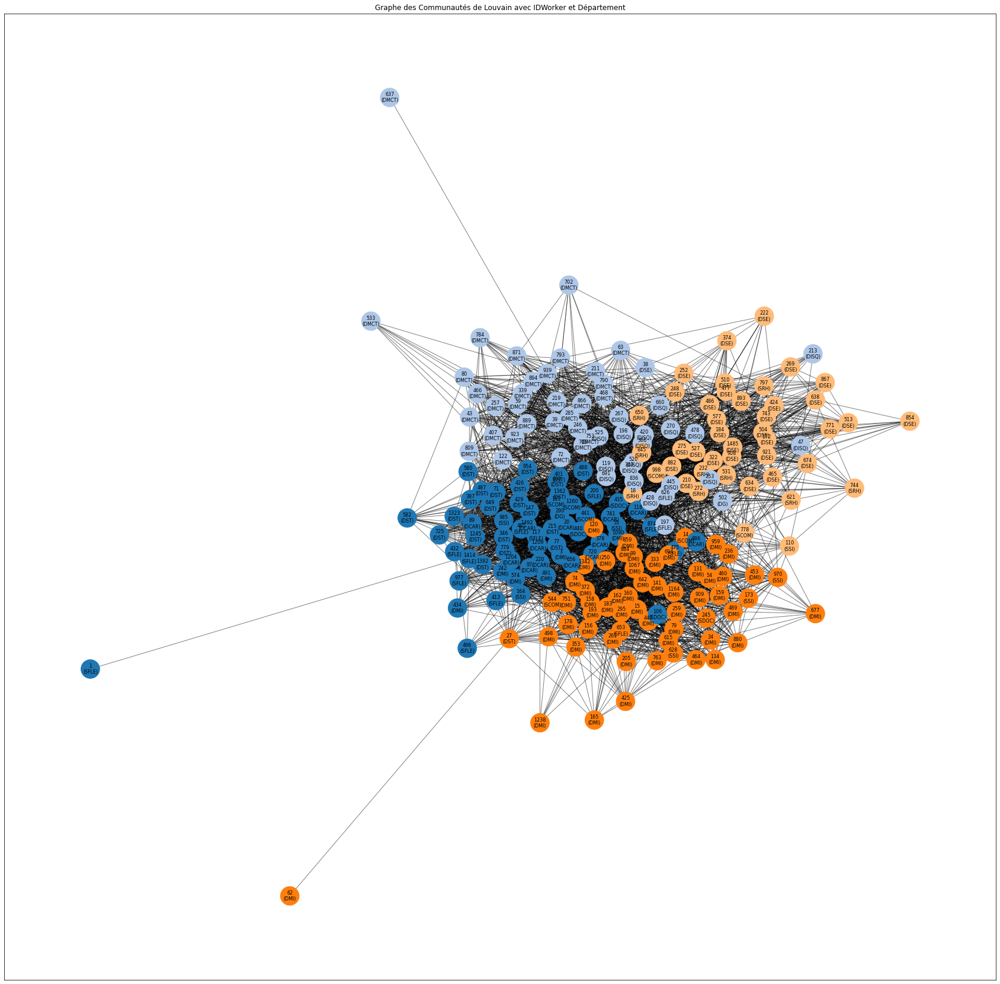

Nombre total de communautés détectées: 4

Communautés détectées avec subdivision par département:

Communauté 1:
  Département SFLE: [1, 1414, 413, 432, 200, 461, 977, 475, 874, 496, 117]
  Département DMI: [3, 434, 574, 1090, 491, 242]
  Département DST: [387, 649, 779, 401, 147, 426, 1323, 429, 954, 580, 582, 71, 77, 1362, 725, 215, 603, 1245, 346, 487, 488, 1392]
  Département DCAR: [656, 20, 1204, 1209, 720, 1492, 89, 220, 97, 741, 886, 118, 378]
  Département DG: [290]
  Département SSI: [164, 55, 985]
  Département SDOC: [435, 440, 106]
  Département SCOM: [181, 441, 1260]

Communauté 2:
  Département DMCT: [257, 637, 784, 533, 790, 407, 793, 923, 285, 39, 809, 939, 43, 59, 702, 63, 706, 72, 80, 466, 339, 211, 468, 219, 866, 871, 753, 246, 889, 122, 894]
  Département DISQ: [520, 267, 525, 270, 660, 420, 428, 47, 691, 445, 836, 198, 213, 343, 478, 366, 119, 253]
  Département DSE: [38]
  Département SFLE: [197, 626]
  Département DG: [502]

Communauté 3:
  Département DMI: [642, 

In [300]:
# Création du graphe à partir des données
G = nx.from_pandas_edgelist(contacts_dataframe, 'IDWorker1', 'IDWorker2', create_using=nx.Graph())

# Associer les départements aux nœuds
department_mapping = dict(zip(departments_dataframe['IDWorker'], departments_dataframe['Department']))
nx.set_node_attributes(G, department_mapping, 'department')

# Appliquer l'algorithme de Louvain pour détecter les communautés
communities = nx.algorithms.community.louvain_communities(G)

# Création d'une mapping de couleur pour chaque communauté
colors = [plt.cm.tab20(i) for i in range(len(communities))]
community_color = {}
for i, community in enumerate(communities):
    for node in community:
        community_color[node] = colors[i]

# Récupérer les couleurs des nœuds pour la visualisation
node_colors = [community_color[node] if node in community_color else (1, 1, 1) for node in G.nodes]

# Créer des étiquettes pour les nœuds
node_labels = {node: f'{node}\n({G.nodes[node]["department"]})' for node in G.nodes}

# Dessiner le graphe
plt.figure(figsize=(30, 30))
pos = nx.spring_layout(G, seed=42)
nx.draw_networkx_edges(G, pos, alpha=0.5)
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=1000)
nx.draw_networkx_labels(G, pos, labels=node_labels, font_size=8)
plt.title('Graphe des Communautés de Louvain avec IDWorker et Département')
plt.show()

# Imprimer chaque communauté et le nombre total de communautés
print("Nombre total de communautés détectées:", len(communities))
print("\nCommunautés détectées avec subdivision par département:")

for i, community in enumerate(communities):
    # Grouper les nœuds par département au sein de la communauté
    departments_in_community = {}
    for node in community:
        department = G.nodes[node]['department'] if node in department_mapping else 'Non Spécifié'
        if department in departments_in_community:
            departments_in_community[department].append(node)
        else:
            departments_in_community[department] = [node]

    # Affichage de la communauté et des départements
    print(f"\nCommunauté {i+1}:")
    for department, nodes in departments_in_community.items():
        print(f"  Département {department}: {nodes}")


Graphe non-orienté des employés par département

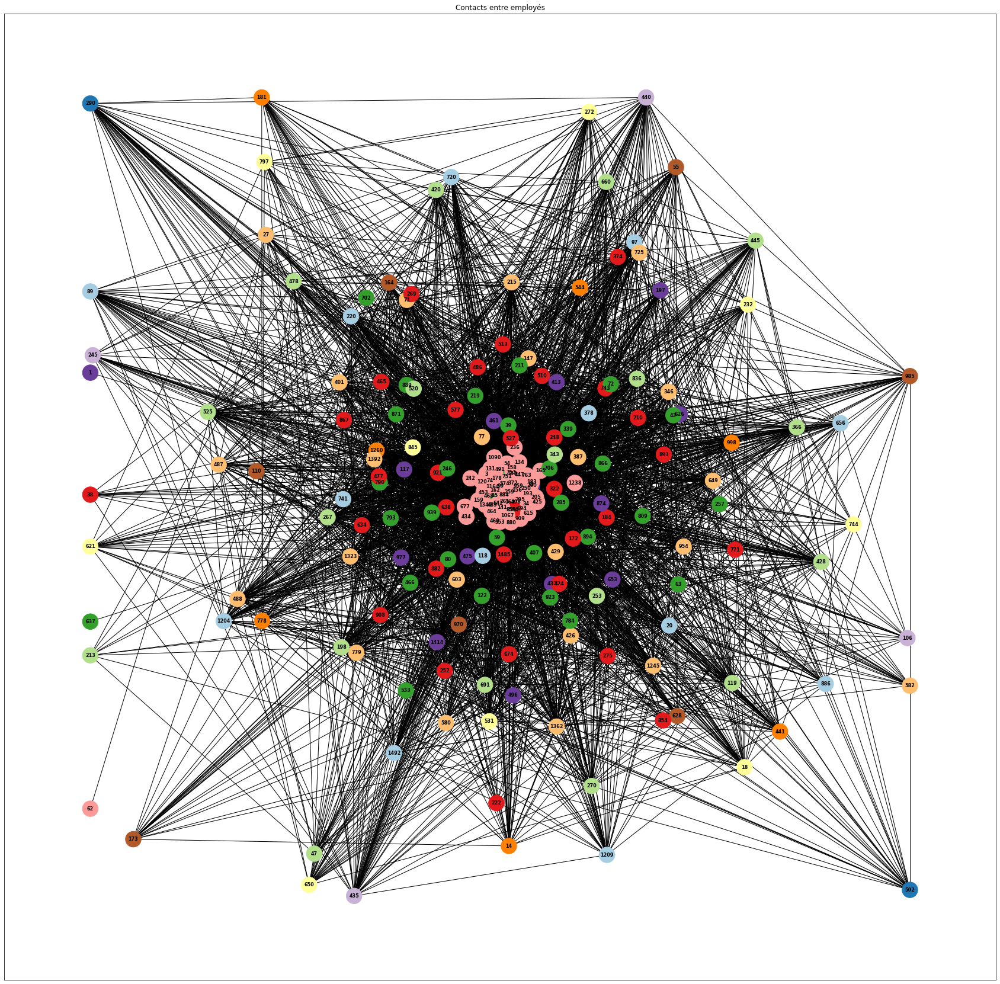

In [301]:
# Créer un graphe dirigé à partir du premier dataset
G = nx.from_pandas_edgelist(contacts_dataframe, 'IDWorker1', 'IDWorker2', ['Duration'], create_using=nx.Graph())

# Ajouter les départements comme attributs aux nœuds
department_mapping = dict(zip(departments_dataframe['IDWorker'], departments_dataframe['Department']))
for node in G.nodes:
    if node in department_mapping:
        G.nodes[node]['Department'] = department_mapping[node]

# Définir une couleur par défaut pour les nœuds sans attribut 'Department'
default_color = 'gray'

# Récupérer les couleurs des nœuds
node_colors = [G.nodes[node].get('Department', default_color) for node in G.nodes]

# Créer une palette de couleurs pour chaque département
unique_departments = departments_dataframe['Department'].unique()
colors = [plt.cm.Paired(i / len(unique_departments)) for i in range(len(unique_departments))]
department_color_mapping = dict(zip(unique_departments, colors))

# Positionner les nœuds par département
pos = {}
for department in unique_departments:
    nodes_in_department = [node for node, attrs in G.nodes(data=True) if 'Department' in attrs and attrs['Department'] == department]
    pos.update(nx.spring_layout(G.subgraph(nodes_in_department), seed=42))

# Dessiner le graphe avec des couleurs par département et regrouper physiquement les nœuds
fig, ax = plt.subplots(figsize=(30, 30))
nx.draw_networkx_nodes(G, pos, node_color=[department_color_mapping.get(color, default_color) for color in node_colors], node_size=700)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black', font_weight='bold')
nx.draw_networkx_edges(G, pos)

# Afficher le graphe sans les noms sur les arêtes
plt.title("Contacts entre employés")
plt.show()

Graphe non-orienté des départements

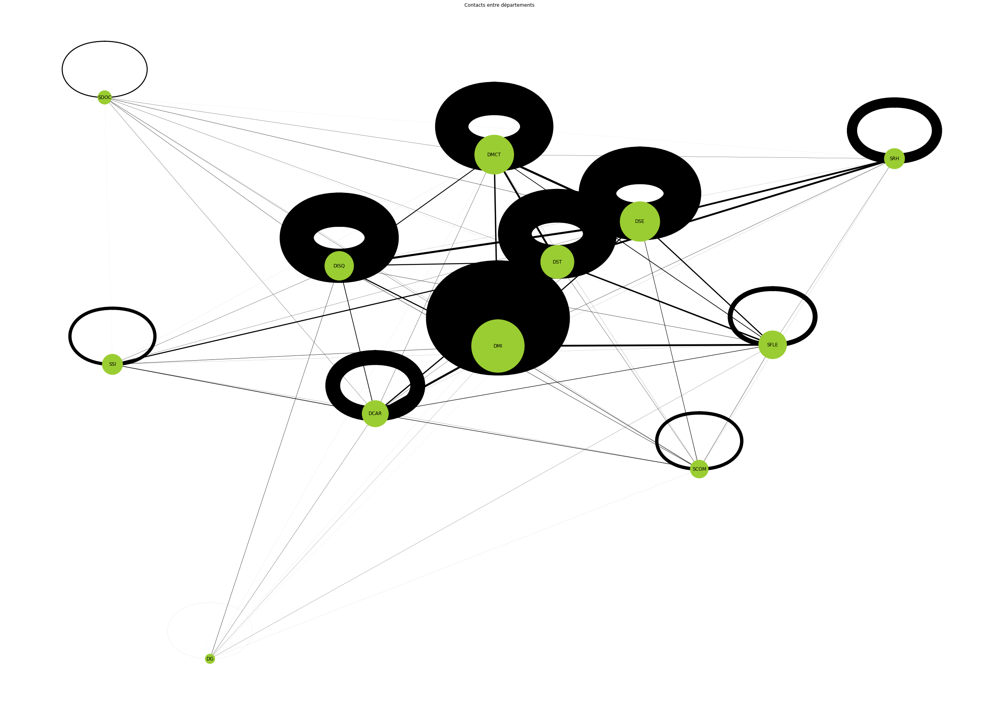

In [302]:
# Préparation des données pour le graphe
# Fusion des données de contacts avec les informations sur les départements
dept_contacts = pd.merge(contacts_dataframe, departments_dataframe, left_on='IDWorker1', right_on='IDWorker')
dept_contacts = pd.merge(dept_contacts, departments_dataframe, left_on='IDWorker2', right_on='IDWorker', suffixes=('_1', '_2'))

# Calcul du nombre de contacts entre chaque paire de départements
dept_contact_counts = dept_contacts.groupby(['Department_1', 'Department_2']).size().reset_index(name='ContactCount')

# Création du graphe
G_dept = nx.Graph()

# Ajout des nœuds (départements) avec la taille basée sur le nombre de personnes dans chaque département
dept_sizes = departments_dataframe['Department'].value_counts()
for dept, size in dept_sizes.items():
    G_dept.add_node(dept, size=size)

# Ajout des arêtes (contacts entre départements) avec l'épaisseur basée sur le nombre de contacts
for row in dept_contact_counts.itertuples():
    G_dept.add_edge(row.Department_1, row.Department_2, weight=row.ContactCount)

# Mise à l'échelle de la taille des nœuds et de l'épaisseur des arêtes pour la visualisation
node_sizes = [G_dept.nodes[node]['size'] * 300 for node in G_dept.nodes]  # Multiplier par un facteur pour la visibilité
edge_widths = [G_dept[u][v]['weight'] / 100 for u, v in G_dept.edges]  # Diviser par un facteur pour l'échelle

# Visualisation du graphe
plt.figure(figsize=(35, 25))
nx.draw(G_dept, with_labels=True, node_size=node_sizes, width=edge_widths, node_color='yellowgreen', edge_color='black')
plt.title("Contacts entre départements")
plt.show()

Distribution de degrés

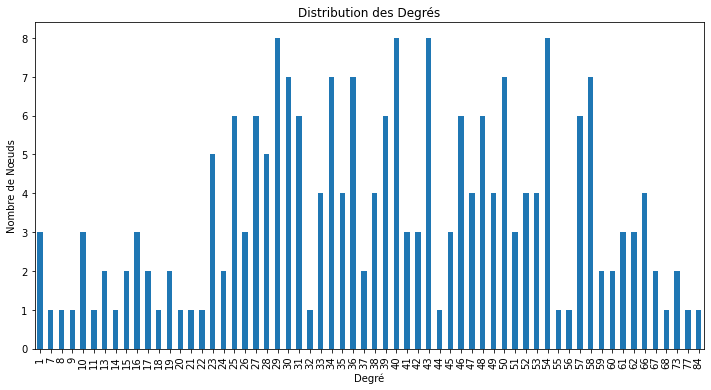

Degré moyen: 39.39


In [303]:
# Calculer les degrés de tous les nœuds
degrees = [degree for node, degree in G.degree()]

# Calculer la distribution de degrés
degree_counts = pd.Series(degrees).value_counts().sort_index()

# Visualiser la distribution de degrés
plt.figure(figsize=(12, 6))
degree_counts.plot(kind='bar')
plt.title('Distribution des Degrés')
plt.xlabel('Degré')
plt.ylabel('Nombre de Nœuds')
plt.show()

# Degré moyen
average_degree = sum(dict(G.degree()).values()) / num_nodes

# Affichage des informations
print(f"Degré moyen: {average_degree:.2f}")

Graphe du degré de centralité

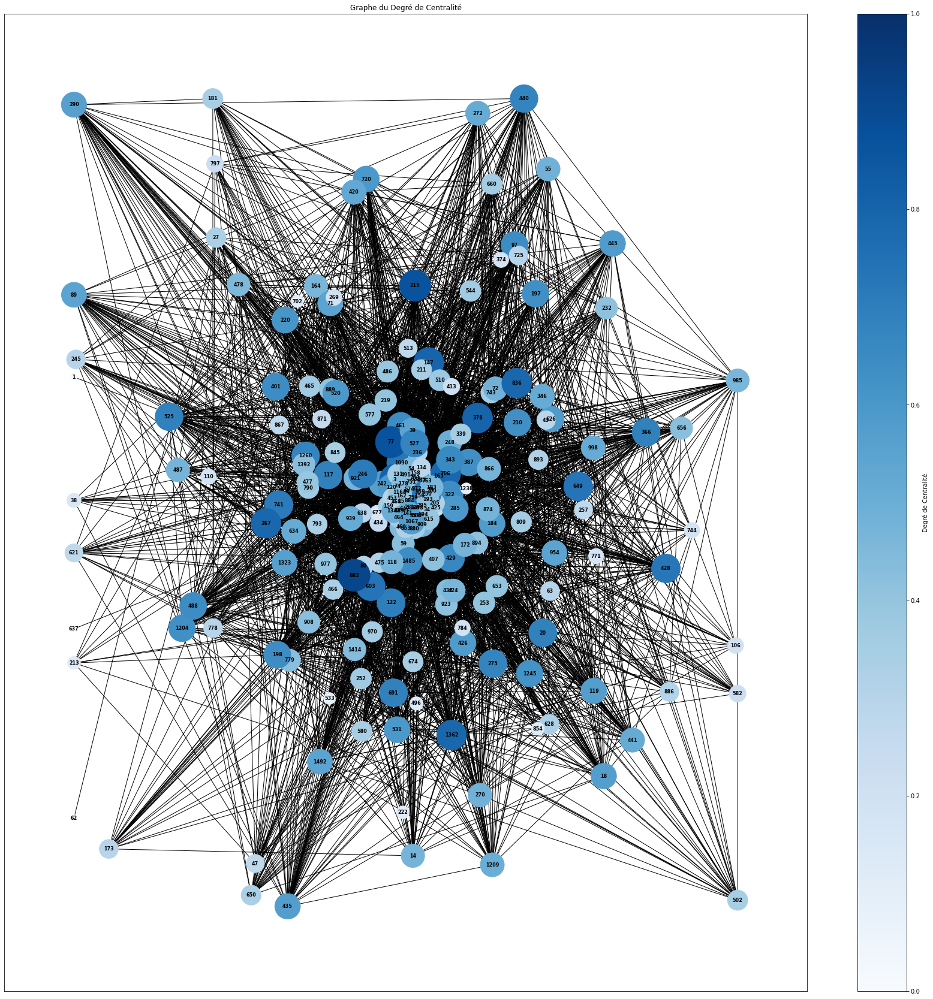

Nœud avec le plus haut degré de centralité : 884 (valeur : 0.38888888888888884)
Nœud avec le plus bas degré de centralité : 62 (valeur : 0.004629629629629629)


In [304]:
# Calcul du degré de centralité
degree_centrality = nx.degree_centrality(G)

# Utilisation de la colormap 'Blues' pour l'échelle de couleur bleue
cmap = plt.cm.get_cmap('Blues')
degree_values = list(degree_centrality.values())
max_degree_value = max(degree_values)
color_map = [cmap(value/max_degree_value) for value in degree_values]

# Ajustement de la taille des nœuds en fonction du degré de centralité
node_size = [value / max_degree_value * 3000 + 100 for value in degree_values]  # Ajustez selon vos besoins

# Dessin du graphe
plt.figure(figsize=(30, 30))
nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=node_size)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black', font_weight='bold')
nx.draw_networkx_edges(G, pos)
plt.title('Graphe du Degré de Centralité')
plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), ax=plt.gca(), orientation='vertical', label='Degré de Centralité')
plt.show()

# Trouver le nœud avec le plus haut degré de centralité
max_degree_centrality_node = max(degree_centrality, key=degree_centrality.get)
max_degree_centrality_value = degree_centrality[max_degree_centrality_node]

# Trouver le nœud avec le plus bas degré de centralité
min_degree_centrality_node = min(degree_centrality, key=degree_centrality.get)
min_degree_centrality_value = degree_centrality[min_degree_centrality_node]

# Affichage
print(f"Nœud avec le plus haut degré de centralité : {max_degree_centrality_node} (valeur : {max_degree_centrality_value})")
print(f"Nœud avec le plus bas degré de centralité : {min_degree_centrality_node} (valeur : {min_degree_centrality_value})")

Graphe de la centralité de proximité

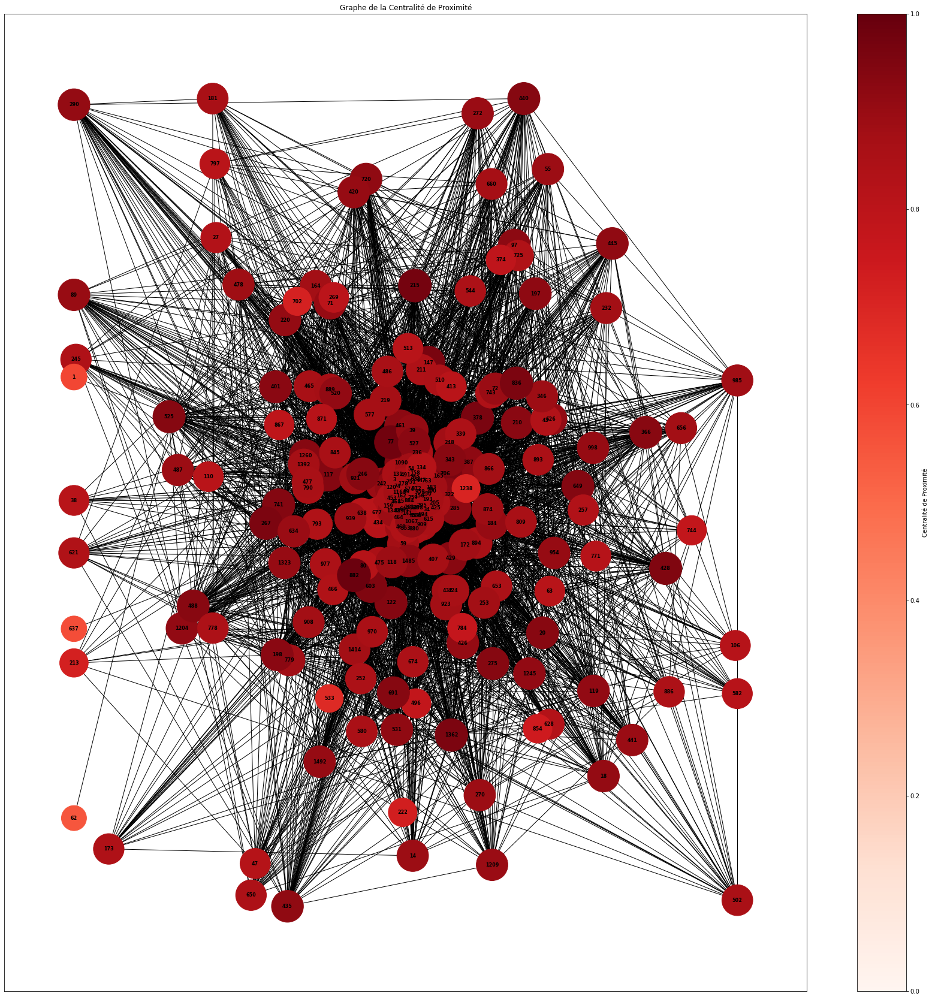

Nœud avec la plus haute centralité de proximité : 884 (valeur : 0.6118980169971672)
Nœud avec la plus basse centralité de proximité : 62 (valeur : 0.3375)


In [305]:
# Calcul de la centralité de proximité
closeness_centrality = nx.closeness_centrality(G)

# Utilisation de la colormap 'Reds' pour l'échelle de couleur rouge
cmap = plt.cm.get_cmap('Reds')
closeness_values = list(closeness_centrality.values())
max_closeness_value = max(closeness_values)
color_map = [cmap(value/max_closeness_value) for value in closeness_values]

# Ajustement de la taille des nœuds en fonction de la centralité de proximité
node_size = [value / max_closeness_value * 3000 + 100 for value in closeness_values]  # Ajustez selon vos besoins

# Dessin du graphe
plt.figure(figsize=(30, 30))
nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=node_size)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black', font_weight='bold')
nx.draw_networkx_edges(G, pos)
plt.title('Graphe de la Centralité de Proximité')
plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), ax=plt.gca(), orientation='vertical', label='Centralité de Proximité')
plt.show()

# Trouver le nœud avec la plus haute centralité de proximité
max_closeness_centrality_node = max(closeness_centrality, key=closeness_centrality.get)
max_closeness_centrality_value = closeness_centrality[max_closeness_centrality_node]

# Trouver le nœud avec la plus basse centralité de proximité
min_closeness_centrality_node = min(closeness_centrality, key=closeness_centrality.get)
min_closeness_centrality_value = closeness_centrality[min_closeness_centrality_node]

# Affichage
print(f"Nœud avec la plus haute centralité de proximité : {max_closeness_centrality_node} (valeur : {max_closeness_centrality_value})")
print(f"Nœud avec la plus basse centralité de proximité : {min_closeness_centrality_node} (valeur : {min_closeness_centrality_value})")

Graphe de la centralité d'intermédiarité

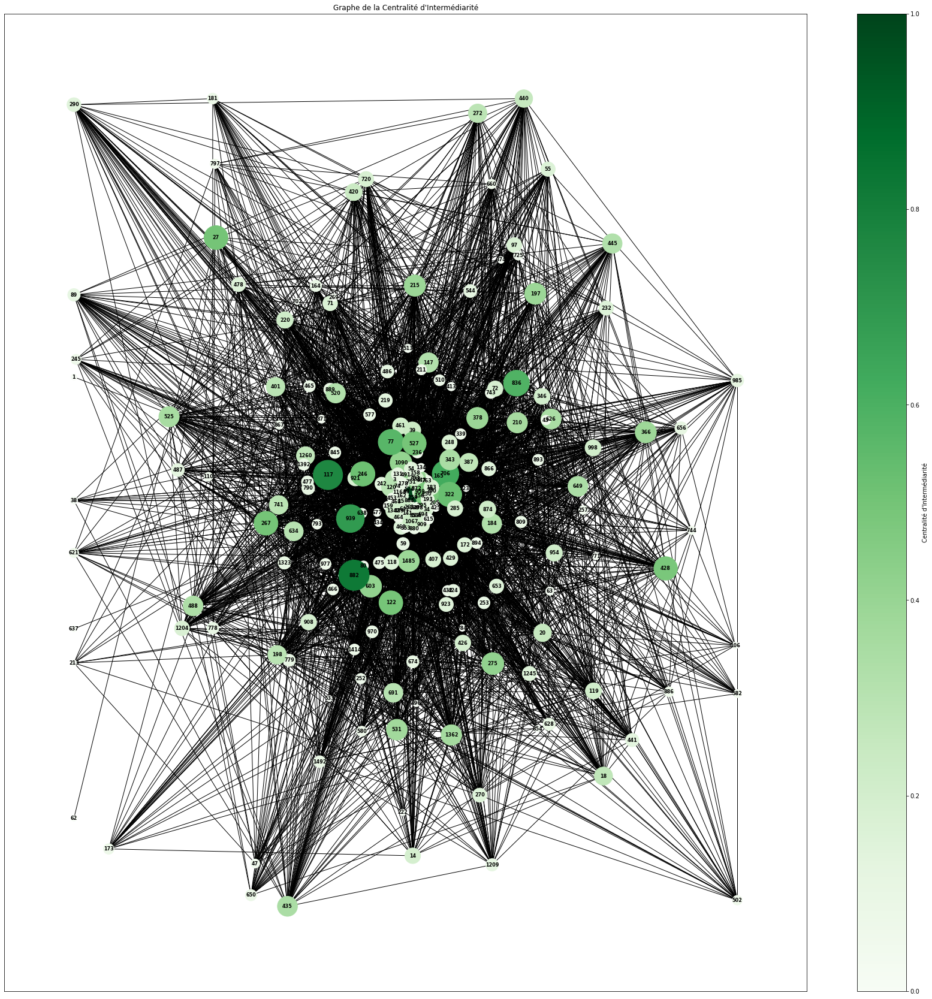

Nœud avec la plus haute centralité d'intermédiarité : 884 (valeur : 0.021945101050667538)
Nœud avec la plus basse centralité d'intermédiarité : 62 (valeur : 0.0)


In [306]:
# Calcul de la centralité d'intermédiarité
betweenness_centrality = nx.betweenness_centrality(G)

# Utilisation de la colormap 'Greens' pour l'échelle de couleur verte
cmap = plt.cm.get_cmap('Greens')
betweenness_values = list(betweenness_centrality.values())
max_betweenness_value = max(betweenness_values)
color_map = [cmap(value/max_betweenness_value) for value in betweenness_values]

# Ajustement de la taille des nœuds en fonction de la centralité d'intermédiarité
node_size = [value / max_betweenness_value * 3000 + 100 for value in betweenness_values]  # Ajustez selon vos besoins

# Dessin du graphe
plt.figure(figsize=(30, 30))
nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=node_size)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black', font_weight='bold')
nx.draw_networkx_edges(G, pos)
plt.title('Graphe de la Centralité d\'Intermédiarité')
plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), ax=plt.gca(), orientation='vertical', label='Centralité d\'Intermédiarité')
plt.show()

# Trouver le nœud avec la plus haute centralité d'intermédiarité
max_betweenness_centrality_node = max(betweenness_centrality, key=betweenness_centrality.get)
max_betweenness_centrality_value = betweenness_centrality[max_betweenness_centrality_node]

# Trouver le nœud avec la plus basse centralité d'intermédiarité
min_betweenness_centrality_node = min(betweenness_centrality, key=betweenness_centrality.get)
min_betweenness_centrality_value = betweenness_centrality[min_betweenness_centrality_node]

# Affichage
print(f"Nœud avec la plus haute centralité d'intermédiarité : {max_betweenness_centrality_node} (valeur : {max_betweenness_centrality_value})")
print(f"Nœud avec la plus basse centralité d'intermédiarité : {min_betweenness_centrality_node} (valeur : {min_betweenness_centrality_value})")

Graphe de la centralité de vecteur propre

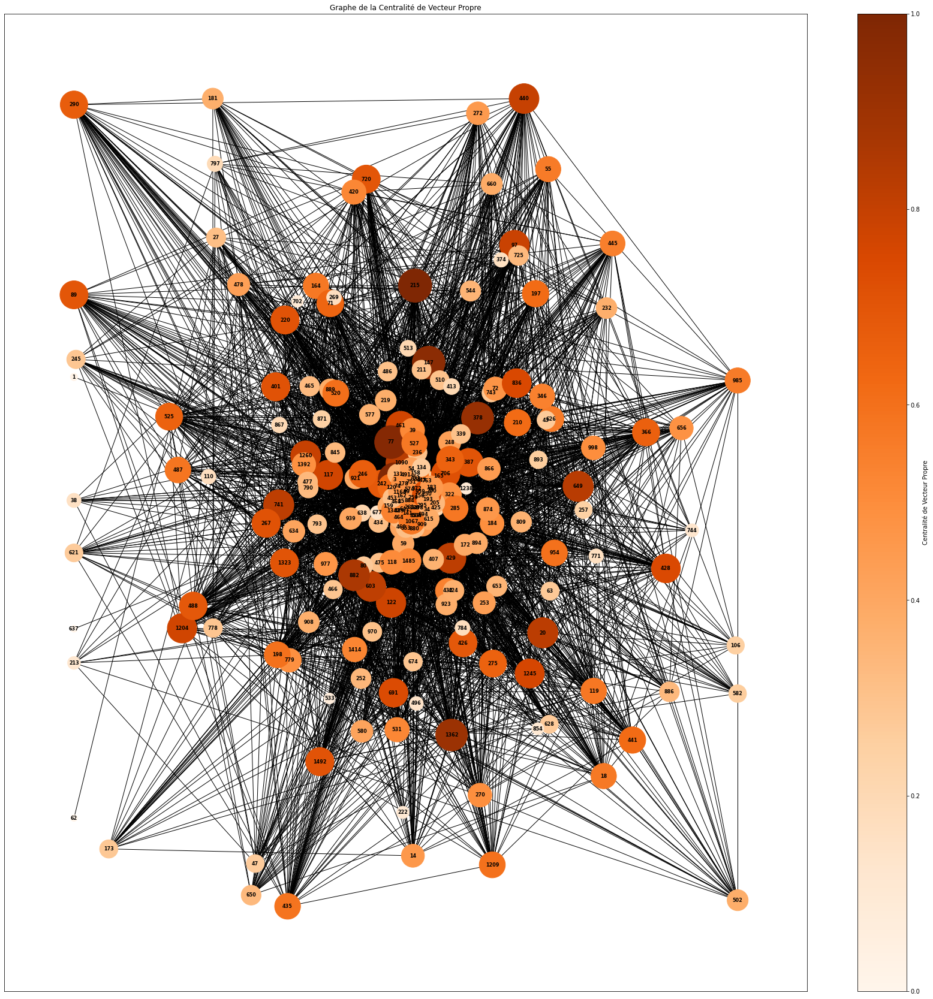

Nœud avec la plus haute centralité de vecteur propre : 215 (valeur : 0.129757420421222)
Nœud avec la plus basse centralité de vecteur propre : 62 (valeur : 0.0008899986302496938)


In [307]:
# Calcul de la centralité de vecteur propre
eigenvector_centrality = nx.eigenvector_centrality(G)

# Utilisation de la colormap 'Oranges' pour l'échelle de couleur orange
cmap = plt.cm.get_cmap('Oranges')
eigenvector_values = list(eigenvector_centrality.values())
max_eigenvector_value = max(eigenvector_values)
color_map = [cmap(value/max_eigenvector_value) for value in eigenvector_values]

# Ajustement de la taille des nœuds en fonction de la centralité de vecteur propre
node_size = [value / max_eigenvector_value * 3000 + 100 for value in eigenvector_values]  # Ajustez selon vos besoins

# Dessin du graphe
plt.figure(figsize=(30, 30))
nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=node_size)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black', font_weight='bold')
nx.draw_networkx_edges(G, pos)
plt.title('Graphe de la Centralité de Vecteur Propre')
plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), ax=plt.gca(), orientation='vertical', label='Centralité de Vecteur Propre')
plt.show()

# Trouver le nœud avec la plus haute centralité de vecteur propre
max_eigenvector_centrality_node = max(eigenvector_centrality, key=eigenvector_centrality.get)
max_eigenvector_centrality_value = eigenvector_centrality[max_eigenvector_centrality_node]

# Trouver le nœud avec la plus basse centralité de vecteur propre
min_eigenvector_centrality_node = min(eigenvector_centrality, key=eigenvector_centrality.get)
min_eigenvector_centrality_value = eigenvector_centrality[min_eigenvector_centrality_node]

# Affichage
print(f"Nœud avec la plus haute centralité de vecteur propre : {max_eigenvector_centrality_node} (valeur : {max_eigenvector_centrality_value})")
print(f"Nœud avec la plus basse centralité de vecteur propre : {min_eigenvector_centrality_node} (valeur : {min_eigenvector_centrality_value})")

Graphe du coefficient de clustering

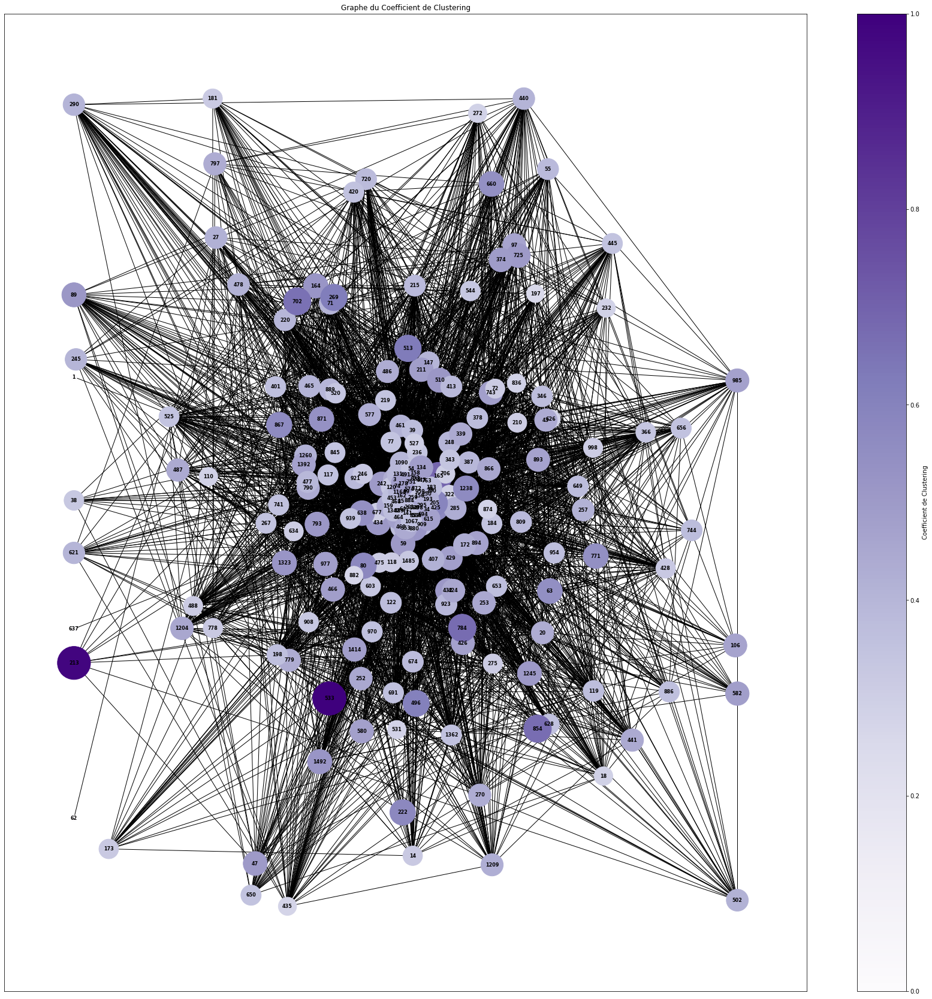

Moyenne du Coefficient de Clustering : 0.38134239603460895


In [308]:
# Calcul du coefficient de clustering pour chaque nœud
clustering_coefficient = nx.clustering(G)

# Utilisation de la colormap 'Purples' pour l'échelle de couleur mauve
cmap = plt.cm.get_cmap('Purples')
clustering_values = list(clustering_coefficient.values())
max_clustering_value = max(clustering_values)
color_map = [cmap(value/max_clustering_value) for value in clustering_values]

# Ajustement de la taille des nœuds en fonction du coefficient de clustering
node_size = [value / max_clustering_value * 3000 + 100 for value in clustering_values]  # Ajustez selon vos besoins

# Dessin du graphe
plt.figure(figsize=(30, 30))
nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=node_size)
nx.draw_networkx_labels(G, pos, font_size=8, font_color='black', font_weight='bold')
nx.draw_networkx_edges(G, pos)
plt.title('Graphe du Coefficient de Clustering')
plt.colorbar(plt.cm.ScalarMappable(cmap=cmap), ax=plt.gca(), orientation='vertical', label='Coefficient de Clustering')
plt.show()

# Calcul de ma moyenne du coefficient de clustering
average_clustering = nx.average_clustering(G)
print(f"Moyenne du Coefficient de Clustering : {average_clustering}")